# Applied Programming Lab
## Keyboard Optimisation Using Simulated Annealing

The objective of this notebook is to demonstrate the use of simulated annealing as a method to solve an NP hard optimisation problem. This solution builds on the last week's solution and thus has a number of functions from that script imported. Ensure that both the files - qwerty_layout.py and keyboard_plot.py are present in the same directory as this notebook for errorless execution.

The documentation for the functions are given in docstrings either in this notebook itself or in the python file(if the function is imported). All of my findings, assumptions and comments are in the report that is submitted alongside the notebook.

Please note that the notebook was initially written with a script in mind and does not contain markdown comments.

Please run the main program(and wait for a while, sorry) to watch the optimisation!

In [1]:
import matplotlib
import matplotlib.pyplot as plt, matplotlib.patches as patches, numpy as np
from scipy.ndimage import gaussian_filter
from matplotlib.colors import LinearSegmentedColormap
from collections import Counter
from math import sqrt
import random, copy
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

from typing import List, Dict, Tuple, Optional, Any
from qwerty_layout import keys, characters

#Using the functions used as part of the previous assignment
from keyboard_plot import get_shift_char, calculate_key_frequencies,draw_key, dist, calc_distance

matplotlib.rcParams['animation.embed_limit'] = 100 #Used to set the maximum embedded memory
#Only required to be set when the keyboard evolution plot is made

In [2]:
def get_neighbor_layout(layout: Dict[str, Dict[str, Any]]) -> Dict[str, Dict[str, Any]]:
    """
    Generates a new keyboard layout by randomly swapping two keys and updating 
    the dependent 'start' key values for the remaining keys.
    
    Parameters:
    layout (Dict[str, Dict[str, Any]]): A dictionary representing the keyboard layout.

    Returns:
    Dict[str, Dict[str, Any]]: A new keyboard layout where two keys are randomly 
    swapped, and the 'start' fields of dependent keys are updated accordingly.
    """
    new_layout = copy.deepcopy(layout) #Making a deepcopy to ensure the original layout does not get changed

    keys_list = list(layout.keys())
    key1, key2 = random.sample(keys_list, 2) #Randomly choosing two keys to perform the swapping

    new_layout[key1], new_layout[key2] = new_layout[key2], new_layout[key1]

    start1, start2 = new_layout[key1]['start'], new_layout[key2]['start'] #Modifying the homerow keys of the dependent keys
    for key in new_layout:
        if new_layout[key]['start'] == key1:
            new_layout[key]['start'] = key2
        elif new_layout[key]['start'] == key2:
            new_layout[key]['start'] = key1
    return new_layout

In [3]:
def simulated_annealing(
    string: str,
    layout: list,
    init_temp: float,
    cool_rate: float,
    max_iter: int,
    cutoff_thresh: float
) -> tuple:
    """
    Performs simulated annealing optimization to minimize the cost of transforming the initial layout based on the input string.

    Args:
        string (str): The input string used for cost computation.
        layout (list): Initial layout representing the current state.
        init_temp (float): Initial temperature for simulated annealing. A higher temperature allows more exploration.
        cool_rate (float): Cooling rate (0 < cool_rate < 1), a factor by which the temperature is reduced at each step.
        max_iter (int): Maximum number of iterations the annealing process will perform.
        cutoff_thresh (float): Threshold factor (0 < cutoff_thresh <= 1) used to determine early stopping based on cost reduction. 

    Returns:
        tuple: A tuple containing:
            - HTML: Animated plot of the annealing progress, showing cost reduction over time.
            - list: Best layouts found during the process.
            - list: Corresponding best costs at each step.
            - list: Current costs for each iteration.

    The function performs simulated annealing by exploring neighboring layouts and accepting or rejecting them 
    based on a temperature-dependent probability. The temperature decreases with each iteration, reducing the likelihood 
    of accepting higher-cost layouts over time. An animation is generated that visualizes the progress, displaying how 
    the current and best costs evolve over the iterations.
    
    The cooling process continues until either the maximum number of iterations is reached or the best cost is below the 
    cutoff threshold compared to the initial cost.
    """
    string = string.rstrip()
    current_layout = layout
    current_cost = compute_cost(current_layout, string)
    init_cost = current_cost
    best_layout = current_layout.copy()
    best_cost = current_cost
    temp = init_temp
    costs = [best_cost]
    best_layouts = [layout]
    best_costs = [best_cost]
    counter = 0

    fig, (ax2) = plt.subplots(1, 1, figsize=(20, 8))
    plt.close()

    def animate(frame):
        nonlocal current_layout, current_cost, best_layout, best_cost, temp, counter
        # Check if the maximum iterations or cost condition is met
        if counter < max_iter and best_cost > cutoff_thresh * init_cost:
            new_layout = get_neighbor_layout(current_layout)
            new_cost = compute_cost(new_layout, string)
            probability = 1 / (1 + np.exp(-(current_cost - new_cost) / temp))
            if new_cost < current_cost or random.random() < probability:
                current_layout = new_layout
                current_cost = new_cost
                if current_cost < best_cost:
                    best_layout = current_layout.copy()
                    best_cost = current_cost

            temp *= cool_rate
            costs.append(current_cost)
            best_costs.append(best_cost)
            best_layouts.append(best_layout)
            counter += 1

            # Update cost plot
            ax2.clear()
            ax2.plot(costs, label='Current Cost')
            ax2.plot(best_costs, label='Best Cost')
            ax2.set_xlabel('Iteration')
            ax2.set_ylabel('Cost')
            ax2.set_title('Annealing Progress')
            ax2.legend()
        
        # If threshold is crossed stop the animation
        else:
            anim.event_source.stop()

        return ax2

    anim = FuncAnimation(fig, animate, frames=max_iter, interval=50, blit=False, repeat=False)

    # Display the animation
    return HTML(anim.to_jshtml()), best_layouts, best_costs, costs


In [4]:
def create_heatmap_data(layout, key_frequencies, resolution=1000):
    """
    Generates heatmap data based on the frequency of key presses and the positions of keys.
    
    Parameters:
    key_frequencies (Dict[str, float]): A dictionary where keys are characters and values are their frequencies.
    resolution (int): The resolution of the heatmap grid, defining the number of points per dimension.
    
    Returns:
    np.ndarray: A 2D numpy array representing the heatmap data, where the value at each point corresponds
    to the intensity of key presses at that location.
    """
    
    x = np.linspace(-1, 15, resolution)
    y = np.linspace(-1, 6, resolution)
    xx, yy = np.meshgrid(x, y)
    
    heatmap = np.zeros((resolution, resolution))
    
    for key, freq in key_frequencies.items():
        if key in layout:
            pos = layout[key]['pos']
            heatmap += freq * np.exp(-((xx - pos[0])**2 + (yy - pos[1])**2) / 0.5)
    
    return gaussian_filter(heatmap, sigma=2)

An assumption that all the keys are of the same size and any key can be placed anywhere is implicit here. This means that the keyboard will not sport a decorative or well engineered look. Although this is possible to be implemented, I have chosen to ignore it bearing the other constraints.

In [5]:
def draw_keyboard(layout, title, text=None):
    """
    Draws a visual representation of the keyboard along with a heatmap indicating key press frequencies.
    
    Parameters:
    text (Optional[str]): The input text to analyze key frequencies.
    If not provided, the empty keyboard layout is shown.
    
    Returns:
    None: Displays the keyboard with a heatmap overlaid.
    """
    keys = layout
    fig, ax = plt.subplots(figsize=(20, 8))

    if text:
        key_frequencies = calculate_key_frequencies(text)
        max_freq = max(key_frequencies.values()) if key_frequencies else 1
    else:
        key_frequencies = {}
        max_freq = 1

    heatmap_data = create_heatmap_data(layout, key_frequencies)

    rainbow = plt.get_cmap('rainbow')

    colors = [1, 1, 1]
    num_colors = 256
    new_colors = [colors] + [rainbow(i / (num_colors - 1)) for i in range(num_colors)]


    cmap = LinearSegmentedColormap.from_list('custom_rainbow', new_colors, N=num_colors)

    shift = 0.5
    img = ax.imshow(heatmap_data, extent=[0 + shift - 1, 15 + shift, 0 + shift - 1, 6 + shift], origin='lower', cmap=cmap, alpha=1)
    cbar = plt.colorbar(img, ax=ax)
    cbar.set_label('Frequency of Strokes', rotation=270, labelpad=20)
    
    #special_keys = ['Shift_L', 'Shift_R', 'Ctrl_L', 'Ctrl_R', 'Alt_L', 'Alt_R', 'Space']
    
    special_keys = [] #Ensures any key can be switched to any place
    key_sizes = {}

    for key, info in keys.items():
        if key in special_keys:
            if key.startswith('Shift'):
                key_sizes[key] = (2, 1)
            elif key.startswith('Ctrl') or key.startswith('Alt'):
                key_sizes[key] = (1.5, 1)
            elif key == 'Space':
                key_sizes[key] = (6, 1)
        else:
            key_sizes[key] = (1, 1)

    for key, info in keys.items():
        draw_key(ax, key, info, key_sizes[key])

    ax.set_xlim(-1, 15 + 1)
    ax.set_ylim(-1, 6)
    ax.set_aspect('equal', adjustable='box')

    plt.axis('off')
    plt.title(title, fontsize=16)
    plt.show()

In [6]:
def compute_cost(layout: Dict[str, Dict[str, Any]], string: str) -> float:
    """
    Computes the total cost of typing a given string based on the layout of the keyboard.

    Parameters:
    layout (Dict[str, Dict[str, Any]]): A dictionary representing the keyboard layout.
    string (str): The input string for which the total typing cost is to be calculated.

    Returns:
    float: The total cost of typing the given string based on the distances of 
    each character in the layout.
    """
    tl = 0
    for character in string:
        tl += calc_distance(character, layout, characters)
    return tl

In [7]:
def get_input():
    lines = []
    while True:
        line = input()
        if line:
            lines.append(line.rstrip())
        else:
            break
        text = ' '.join(lines)
    return text

A little bit of comment on the initial values used in the main function. They have been arbitrarily chosen to ensure that the test cases that I had in mind are executed quickly. The program might take a while to execute when the number of iterations are large - I have implemented early stopping to avoid this issue as much as possible.

In [8]:
def main():
    
    print("Enter the text for keyboard optimisation")
    input_text = get_input()

    init_temp = 100 # the initial temperature depending which the probability decreases 
    cool_rate = 0.99 # the cooling rate of the heat function
    max_iter = 500
    cost_thresh = 0.3 # percentage of initial cost for early stopping
    layout = keys
    animation, best_layouts, best_costs, costs = simulated_annealing(input_text.rstrip(), layout, init_temp, cool_rate, max_iter, cost_thresh)

    display(animation)
    
    draw_keyboard(best_layouts[0], "Original QWERTY Layout", input_text)
    draw_keyboard(best_layouts[-1], "Optimised keyboard layout", input_text)

Enter the text for keyboard optimisation


 Lorem ipsum dolor sit amet, consectetur adipiscing elit, sed do eiusmod tempor incididunt ut labore et dolore magna aliqua. 
 Ut enim ad minim veniam, quis nostrud exercitation ullamco laboris nisi ut aliquip ex ea commodo consequat. Duis aute irure dolor in reprehenderit in voluptate velit esse cillum dolore eu fugiat nulla pariatur.
 


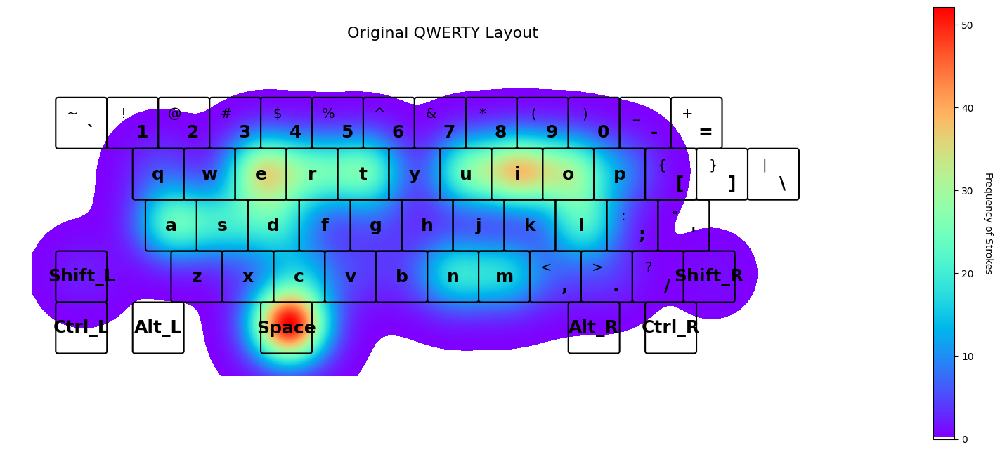

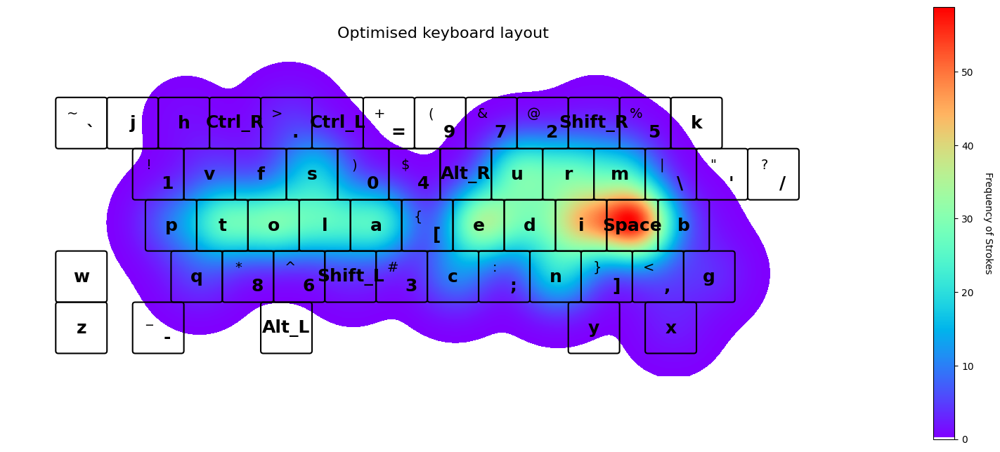

In [9]:
if __name__ == "__main__":
    main()